# 🔥 Diffusion Models

In this notebook, we'll walk through the steps required to train your own diffusion model on the Oxford flowers dataset

The code is adapted from the excellent ['Denoising Diffusion Implicit Models' tutorial](https://keras.io/examples/generative/ddim/) created by András Béres available on the Keras website.

In [2]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


IPython是Jupyter Notebook的运行基础，是交互式python解释器，
有魔法命令、命令补全、历史命令、多行代码块等普通python解释器所不具备的功能。

这两行代码是IPython中的魔术命令（Magic Command）。
它们用于启用自动重新加载（autoreload）模块，以便在代码修改后自动重新加载模块，而无需手动重新启动内核或重新导入模块。

%load_ext autoreload 这一行是加载 IPython 的 autoreload 扩展模块。该扩展模块允许你使用自动重新加载功能。
%autoreload 2 这一行是启用自动重新加载的设置。2 表示在进行代码修改后，模块将被重新加载。

这些命令通常用于开发过程中，特别是当你在编辑模块的代码时，并希望在不退出 Jupyter Notebook 或 IPython 会话的情况下立即看到代码更改的效果。

请注意，这些命令只在 Jupyter Notebook 或 IPython 环境中有效，而不适用于常规的 Python 脚本。在常规的 Python 脚本中，你需要手动重新运行脚本或重新导入模块才能应用代码更改。

In [103]:
import numpy as np
import matplotlib.pyplot as plt

plt.style.use("seaborn-v0_8-colorblind")

In [104]:
import math

In [105]:
# 解决tf一遍遍报警没有正确安装GPU相关资源
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '0'   

In [106]:
import tensorflow as tf  #在cpu运行tf可以忽略以下警告

In [107]:
from tensorflow.keras import (  #这段代码导入了 TensorFlow 中 keras 模块中的多个子模块和类，用于构建深度学习模型和进行相关操作。
    layers,     #包含了构建神经网络模型的各种层（例如全连接层、卷积层、池化层等）。你可以使用这些层来定义模型的结构。
    models,     #包含了模型的定义和操作。你可以使用 models 模块来创建和编译模型，进行训练和评估等操作。
    optimizers, # 包含了各种优化器，用于在训练过程中更新模型参数以最小化损失函数。常见的优化器包括梯度下降法（如 SGD）、Adam、RMSprop 等。
    utils,      #提供了一些实用工具函数，用于数据处理、模型保存和加载、图像预处理等。
    callbacks,  #提供了回调函数，用于在训练过程中执行特定操作，如在每个训练轮结束时保存模型、在训练过程中动态调整学习率等。
    metrics,    #包含了各种评估指标，用于评估模型的性能，如准确率、精确率、召回率等。
    losses,     #提供了各种损失函数，用于定义模型的训练目标。常见的损失函数包括均方误差（MSE）、交叉熵（Cross Entropy）等。
    activations,#包含了各种激活函数，用于引入非线性性质到神经网络中，如ReLU、Sigmoid、Softmax 等。
)

In [108]:
from utils import display, sample_batch  #/app/notebooks/utils.py

tensor与numpy数组的区别：
Tensor维度不限，支持自动微分，稀疏存储，利用GPU做并行运算，常用于深度学习
numpy数组一般二维，在cpu运行，紧凑存储，常用于通用科学计算
tensor转numpy数组主要是为了在Python中处理或可视化数据。

In [109]:
IMAGE_SIZE = 64     #生成图像的大小,这里是64x64
BATCH_SIZE = 64     #批次大小,每个批次输入的样本数目
DATASET_REPETITIONS = 5
LOAD_MODEL = True  #是否加载预训练模型

NOISE_EMBEDDING_SIZE = 32
PLOT_DIFFUSION_STEPS = 20

# optimization
EMA = 0.999  #Exponential Moving Average
LEARNING_RATE = 1e-3
WEIGHT_DECAY = 1e-4  #权重衰减率(L2正则化系数). 它惩罚权重的大值,防止过拟合.
EPOCHS = 50  #训练的轮数(epochs). 即整个训练集要迭代多少次

EMA是指数移动平均的英文缩写。

EMA是一种应用于优化算法中,如SGD随机梯度下降时训练深度神经网络的参数的技巧。

EMA会跟踪模型参数的移动平均值,并在每个训练步更新这个移动平均值。模型的参数值会逐渐“移动”趋近于这个移动平均值。

EMA的公式如下:

EMA(新) = α * EMA(旧) + (1-α) * 当前参数值

这里α是EMA的衰减率,取值范围从0到1,常用值是0.999。

通过EMA,实际上我们维护了两个版本的模型参数——实际用于训练的参数值,和EMA的参数值。

在验证和预测时,我们使用EMA后的参数值,而不是实际的参数值。这能平滑参数,提高泛化能力。

总之,EMA通过在训练过程中求均值来进一步优化模型,获得更稳定的效果。衰减率控制移动平均值的更新速度。

简而言之,EMA技巧能通过时间上平均参数来继续优化模型,从而提升模型在验证集上表现。

## 数据准备

In [110]:
import os
os.getcwd()  

'/Users/leiou/Desktop/workspace/foster/GDL2E/notebooks/08_diffusion/01_ddm'

In [124]:
#load the data，total 8190pics，resize to 64x64; 
train_data=utils.image_dataset_from_directory(
    "/Users/leiou/Desktop/workspace/foster/GDL2E/data/pytorch-challange-flower-dataset/dataset",
    labels=None,
    image_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=None, #一种习惯，预处理后指定batch较好
    shuffle=False, #True,
    seed=None, #42,
    interpolation="bilinear",#采用双线性插值进行resize
)
train_data



Found 8190 files belonging to 1 classes.


<_PrefetchDataset element_spec=TensorSpec(shape=(64, 64, 3), dtype=tf.float32, name=None)>

In [125]:
#preprocess the data
def preprocess(img):# 0~255 --->  0~1
    img = tf.cast(img, "float32") / 255.0  #0~1 cast()改变张量的数据类型为浮点32
    return img

train_data=train_data.map(lambda x:preprocess(x))
#map()函数是TensorFlow数据集(tf.data.Dataset)中的一个重要方法。
#它的功能是:对数据集作用于指定的函数,将每个样本传入该函数进行映射(映射成新的数据项)。
#接受一个函数作为参数,这个函数作用于 Dataset 中的每个元素
#将该函数应用到 Dataset 中的每个元素,对每个元素进行映射(映射成新的数据项)
#返回一个新的Dataset对象
#Map操作是并行(parallel)执行的,可以加速数据处理
print(train_data)
len(train_data)

<_MapDataset element_spec=TensorSpec(shape=(64, 64, 3), dtype=tf.float32, name=None)>


8190

In [126]:
train_data=train_data.repeat(DATASET_REPETITIONS)  #5x8190
train_data=train_data.batch(BATCH_SIZE,drop_remainder=True)  #(5*8190)%64=639 
print(len(train_data))
print(train_data)


639
<_BatchDataset element_spec=TensorSpec(shape=(64, 64, 64, 3), dtype=tf.float32, name=None)>


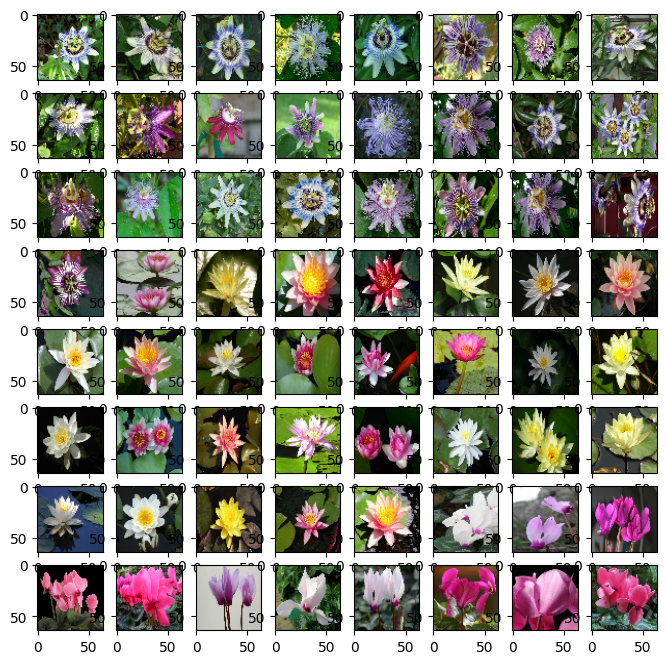

In [130]:
# train_sample=sample_batch(train_data)
# display( train_sample,
#         n=len(train_sample),
#           size=(20, 21),
#             cmap="gray_r", 
#             as_type="float32",
#               save_to=None)
import matplotlib.pyplot as plt
train_sample=train_data.take(1).get_single_element().numpy()
plt.figure(figsize=(8,8))
for i in range(len(train_sample)):
    _ = plt.subplot(8, 8, i + 1)
    plt.imshow(train_sample[i])
    plt.axis("off")


In [131]:
train_sample.shape

(64, 64, 64, 3)

# Diffusion schedules

In [132]:
def linear_diffusion_schedule(diffusion_times): 
    #T:1000 diffusion_times=0, 1/1000, 2/1000，..., 999/1000
    min_rate=0.0001
    max_rate=0.02
    betas=min_rate+diffusion_times*(max_rate-min_rate)
    alphas=1-betas
    alpha_bars=tf.math.cumprod(alphas)
    signal_rates=tf.sqrt(alpha_bars) #signal_rates is sqrt （alpha_bars:t） from t=1 to t=T 
    noise_rates=tf.sqrt(1-alpha_bars)
    return noise_rates,signal_rates

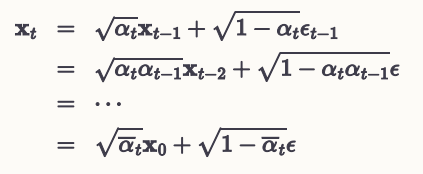

In [133]:
def cosine_diffusion_schedule(diffusion_times):
    signal_rates=tf.cos(diffusion_times*math.pi/2)
    noise_rates=tf.sin(diffusion_times*math.pi/2)
    return noise_rates,signal_rates

In [134]:
def offset_cosine_diffusion_schedule(diffusion_times):
    min_signal_rate=0.02
    max_signal_rate=0.95
    start_angle=tf.acos(max_signal_rate)
    end_angle=tf.acos(min_signal_rate)
    diffusion_angles=start_angle+ diffusion_times*(end_angle-start_angle)
    signal_rates=tf.cos(diffusion_angles)
    noise_rates=tf.sin(diffusion_angles)
    return noise_rates,signal_rates    

In [135]:
T=1000
diffusion_times=tf.convert_to_tensor([x/T for x in range(T)])  #0,0.001,0.002, .. .,0.999
linear_noise_rates,linear_signal_rates=linear_diffusion_schedule(diffusion_times)
cosine_noise_rates,cosine_signal_rates=cosine_diffusion_schedule(diffusion_times)
offset_cosine_noise_rates,offset_cosine_signal_rates=offset_cosine_diffusion_schedule(diffusion_times)

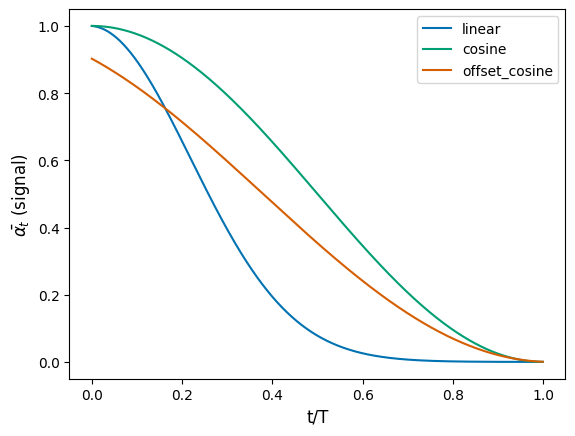

In [136]:
plt.plot(diffusion_times,linear_signal_rates**2,linewidth=1.5,label="linear")
plt.plot(diffusion_times,cosine_signal_rates**2,linewidth=1.5,label="cosine")
plt.plot(diffusion_times,offset_cosine_signal_rates**2,linewidth=1.5,label="offset_cosine")
plt.xlabel("t/T",fontsize=12)
plt.ylabel(r"$\bar{\alpha_t}$ (signal)", fontsize=12) #LaTeX r 表示 \ 不转义
plt.legend() #显示图例
plt.show()

# 2 Build Model

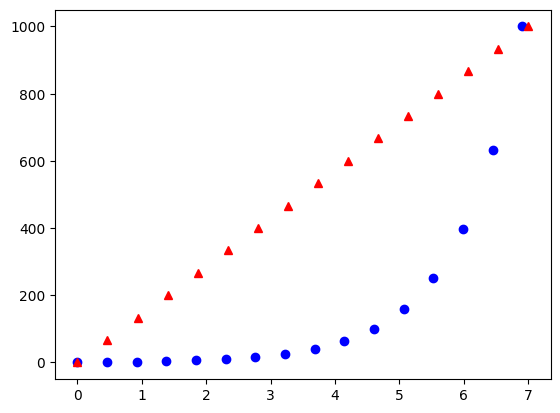

In [152]:
l=  tf.linspace(  # 0 ~ 6.91 均分成15份，从头到尾共16个点
        tf.math.log(1.0),  
        tf.math.log(1000.0),  #写成1000形式会报错
        NOISE_EMBEDDING_SIZE // 2,   #NOISE_EMBEDDING_SIZE = 32
    )
f= tf.exp(l)
plt.plot(l,f,"bo")   #b:blue o:dot
plt.plot(tf.linspace(0.0,7.0,16),1000*tf.linspace(0.0,15.0,16)/15,'r^')

In [166]:
# x一个四维数[[[[0.98]]]]:  逐个0, 0.01, 0.02 ~ 0.98, 0.99 
def sinusoidal_embedding(x): 
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(1.0),
            tf.math.log(1000.0),
            NOISE_EMBEDDING_SIZE // 2,   #NOISE_EMBEDDING_SIZE = 32
        )
    ) 
    #frequencies16个数
    #[1  1.58 2.51 3.98 6.31 
    # 10 15.8 25.1 39.8 63.1
    # 100 158.5 251.1 398.1 630.9 1000】
    angular_speeds = 2.0 * math.pi * frequencies
    # w=angular_speeds*x
    # print(tf.sin(w))
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings
sinusoidal_embedding([[[[0.98]]]])

<tf.Tensor: shape=(1, 1, 1, 32), dtype=float32, numpy=
array([[[[-1.2533310e-01, -3.2804862e-01,  2.3864187e-01,
          -5.8038932e-01,  9.1367078e-01, -9.5105582e-01,
          -1.9942299e-01, -6.6830480e-01,  9.1007642e-02,
          -8.6445302e-01,  9.8197183e-05,  9.0603799e-01,
           8.6024767e-01,  7.8996843e-01,  8.4979224e-01,
           8.5990143e-04,  9.9211472e-01, -9.4466084e-01,
          -9.7110766e-01,  8.1433916e-01,  4.0645498e-01,
           3.0901906e-01, -9.7991353e-01, -7.4388754e-01,
           9.9585021e-01,  5.0271362e-01,  1.0000000e+00,
          -4.2319641e-01,  5.0987637e-01,  6.1314750e-01,
          -5.2711779e-01,  9.9999964e-01]]]], dtype=float32)>

1,在函数内部，创建一个变量 frequencies，它使用 TensorFlow 的 exp 函数生成一个从自然对数 1.0 到自然对数 1000.0 的等间隔序列。这个序列的长度为 NOISE_EMBEDDING_SIZE // 2
2,计算每个频率对应的角速度，将 frequencies 乘以 2π，得到 angular_speeds。
3,使用 TensorFlow 的 concat 函数，将两个张量连接起来，形成一个新的张量 embeddings。其中，第一个张量是 tf.sin(angular_speeds * x)，表示 x 乘以角速度后的正弦值；第二个张量是 tf.cos(angular_speeds * x)，表示 x 乘以角速度后的余弦值。连接操作是沿着第三个维度（axis=3）进行的。
4,将 embeddings 返回作为函数的结果。
简而言之，sinusoidal_embedding 函数通过在不同频率上计算正弦和余弦值，生成了一个嵌入矩阵。该嵌入矩阵的形状为 (1, 1, 1, NOISE_EMBEDDING_SIZE)，其中最后一个维度的一半用于存储正弦值，另一半用于存储余弦值。这样的嵌入矩阵通常在深度学习中用于引入周期性或时间相关性的特征。

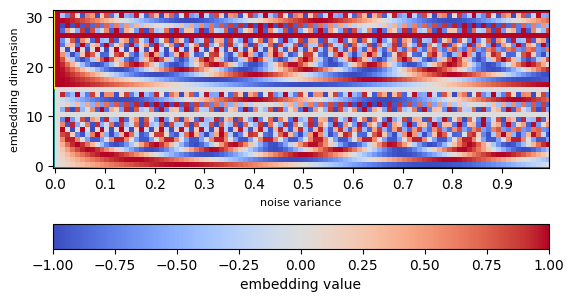

In [170]:
embedding_list=[]
for y in np.arange(0, 1, 0.01):  #0~1 不含1 步长0.01 循环100次 0,0.01,~0.98,0.99
    embedding_list.append( sinusoidal_embedding( np.array([[[[y]]]])) [0][0][0]) 
    #循环中每一步,给sinusoidal_embedding一个y(标量需转为四维)
    #返回四维张量,只取[0][0][0],即只取最后一维
    #最后一维是个长32的向量.把这个向量压入embedding_list
embedding_array=np.array(np.transpose(embedding_list))
#转置以后,纵坐标是那32个数
embedding_array.shape  #(32,100)
fig,ax=plt.subplots()
ax.set_xticks( np.arange(0,100,10), labels=np.round(np.arange(0.0,1.0,0.1),1) )
# 将 x 轴上的刻度设置为指定的数值，并可以选择性地为每个刻度设置标签  
# np.round(np.arange(0.0, 1.0, 0.1), 1) 生成一个从 0.0 到 0.9 的数值序列，步长为 0.1，并进行四舍五入保留1位小数
ax.set_xlabel("noise variance",fontsize=8)
ax.set_ylabel("embedding dimension",fontsize=8)
plt.pcolor(embedding_array,cmap='coolwarm')
#embedding_array 是一个二维数组，即要绘制的数据。值小为蓝,值大为红。
plt.colorbar(orientation="horizontal",label='embedding value')
ax.imshow(embedding_array,interpolation='nearest',origin='lower')

In [33]:
def ResidualBlock(width):  #width是通道数
    def apply(x): # 避免命名冲突;类似对象调用
        input_width=x.shape[3] #shape=[batch,w,h,channels]
        
        #让x的通道数与参数width一致
        if input_width==width:
            residual=x
        else:
            residual=layers.Conv2D(width,kernel_size=1)(x)
        #批归一化:在x的每一批次内,对所有特征做归一化到mean=0;variance=1
        #有点问题:residual没有归一化!!!!!
        x=layers.BatchNormalization(center=False,scale=False)(x)
        #卷积核3x3,共有width个卷积核,意味着输出width个通道.
        #swish是Keras的一种激活函数x=x*sigmoid(x) 它在负值时能传播,正直时类似ReLU
        x=layers.Conv2D(width,kernel_size=3,padding='same',activation=activations.swish)(x)
        x=layers.Conv2D(width,kernel_size=3,padding='same')(x)
        #residual保存的原始特征加到卷积结果上,在反向传播时提供了一条捷径达到深远层,
        #帮助梯度在NN中传的更远,同时缓解梯度消失.
        x=layers.Add()([x,residual])
        return x
    
    return apply

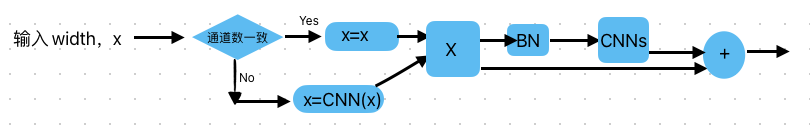

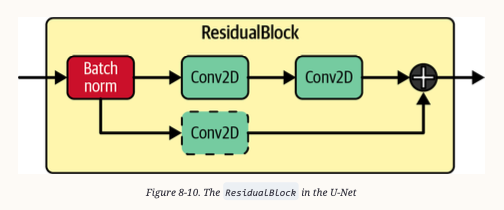


In [23]:
def DownBlock(width,block_depth):  #block_depth指residualBlock的数量
    def apply(x):  #调用实例x=DownBlock(32,block_depth=2)(x,skips)
        x,skips=x
        for _ in range(block_depth):
            x=ResidualBlock(width)(x)
            skips.append(x)
        x=layers.AveragePooling2D(pool_size=2)(x)
        return x
    return apply

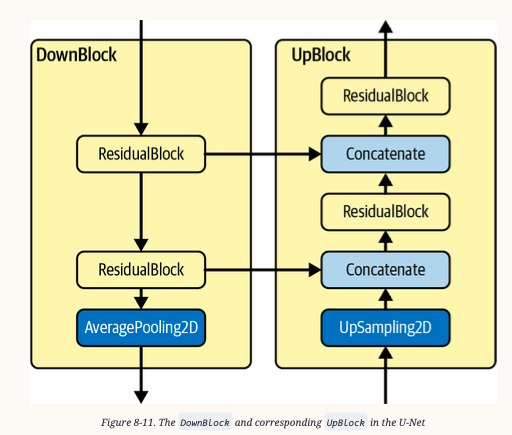

In [24]:
def UpBlock(width,block_depth):
    def apply(x):
        x,skips=x
        x=layers.UpSampling2D(size=2,interpolation="bilinear")(x)
        for _ in range(block_depth):
            x=layers.Concatenate()([x,skips.pop()])
            x=ResidualBlock(width)(x)
        return x
    return apply

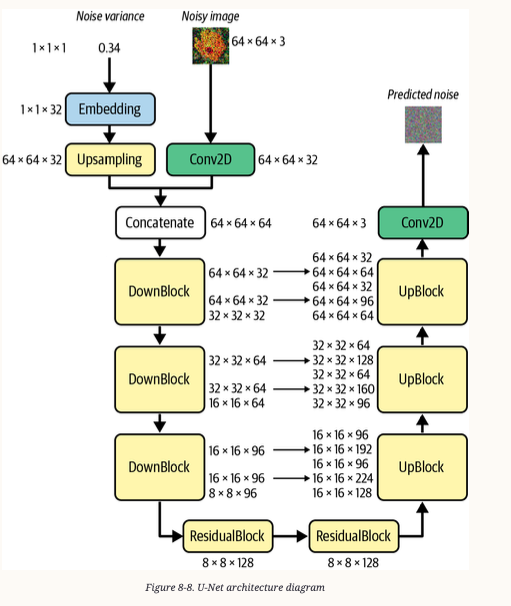

## build U_net

In [30]:
noise_images=layers.Input(shape=(IMAGE_SIZE,IMAGE_SIZE,3)) # 64x64x3
x=layers.Conv2D(32,kernel_size=1)(noise_images)   # 64x64x32

noise_variance=layers.Input(shape=(1,1,1)) # 1x1x1
noise_embedding=layers.Lambda(sinusoidal_embedding)(noise_variance)  # 1x1x32
#layers.Lambda调用sinusodial_embedding()函数,并指定其参数为noise_variance  
noise_embedding=layers.UpSampling2D(size=IMAGE_SIZE,interpolation='nearest')(noise_embedding)  #64x64x32

x=layers.Concatenate()([x,noise_embedding])  #64x64x64
skips=[]

x=DownBlock(32,block_depth=2)([x,skips])  #skips=64x64x32 ouput=32x32x32 
x=DownBlock(64,block_depth=2)([x,skips])  #skips=32x32x64 output=16x16x64
x=DownBlock(96,block_depth=2)([x,skips])  #skips=16x16x96 output=8x8x96

x=ResidualBlock(128)(x)  #8x8x128
x=ResidualBlock(128)(x)  #8x8x128

x = UpBlock(96, block_depth=2)([x, skips])
x = UpBlock(64, block_depth=2)([x, skips])
x = UpBlock(32, block_depth=2)([x, skips])

x=layers.Conv2D(3,kernel_size=1,kernel_initializer='zeros')(x)
unet=models.Model([noise_images,noise_variance],x,name='unet')

In [45]:
class DiffusionModel(models.Model): #继承自models.Model
    def __init__(self):
        super().__init__()  
            #调用父类（models.Model）的构造函数。通过这个语句，DiffusionModel类继承了父类的属性和方法。
        self.normalizer=layers.Normalization()  #mean:=0 variance:=1
            # layers的归一化类Normalization()构造一个实例对象赋值给 self.normalizer
        self.network=unet
        self.ema_network=models.clone_model(self.network)  # equals unet
            #创建了一个名为ema_network的实例变量，它通过调用models.clone_model()函数复制self.network得到network的一个副本
        self.diffusion_schedule=offset_cosine_diffusion_schedule #余弦弥散偏离步骤函数
            #确定模型的diffusion schedule
    def compile(self, **kwargs):
        super().compile(**kwargs) #通过这个语句，模型继承了父类models.Model类的编译行为和属性。
            # 在compile()方法中，通常可以进行一些模型的配置，例如选择优化器、指定损失函数、添加度量指标等。
        
        self.noise_loss_tracker=metrics.Mean(name="n_loss")
            #创建一个名为noise_loss_tracker的实例变量，它是一个metrics.Mean对象，并指定了名称为"n_loss"。
            # metrics.Mean是一个用于跟踪平均值的度量指标（metric），在这里可能用于跟踪噪声损失（noise loss）的平均值。
    @property  #@property装饰器可以将方法转换为属性，使其在访问时不需要使用圆括号。
    def metrics(self):
        return [self.noise_loss_tracker] #这表示在访问模型的metrics属性时，将返回包含noise_loss_tracker的列表
    
    def denormalize(self, images): #反归一化后，数字在0~1,可以用display()显示输出
        #?????
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        #从self.normalizer对象中获取标准化的均值（mean）和方差（variance）。
        #然后，将图像数据images乘以方差的平方根，再加上均值，以进行反标准化操作。
        return tf.clip_by_value(images, 0.0, 1.0)
        #反标准化后的图像数据限制在0.0到1.0之间。tf.clip_by_value()函数将小于0.0的值截断为0.0，将大于1.0的值截断为1.0
        
    def denoise(self, noisy_images, noise_rates, signal_rates, training):  #?????
        if training:
            network = self.network
        else:
            network = self.ema_network
        pred_noises = network( [noisy_images, noise_rates**2], training=training )
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates  #得到 X0

        return pred_noises, pred_images
    
    def reverse_diffusion(self,initial_noise,diffusion_steps): 
        num_images=initial_noise.shape[0]  #白噪声图像数量
        step_size=1.0/diffusion_steps   # e.g. 20
        current_images=initial_noise
        for step in range(diffusion_steps):
            diffusion_times=tf.ones( (num_images,1,1,1) ) - step*step_size  
            #e.g. I-0/20; I-1/20;I-2/20;I-3/20;......I-19/20
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(current_images, noise_rates, signal_rates, training=False)
            # pred_images is x_0 and pred_noise is ε_t which is calculated by unet ??
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule( next_diffusion_times)
            current_images = ( next_signal_rates * pred_images + next_noise_rates * pred_noises )
            # σ_t:=0 will make things deterministic
        return pred_images
    
    #用diffusion_steps步,生成num_images个图像
    def generate(self,num_images,diffusion_steps,initial_noise=None):
        if initial_noise is None:
            initial_noise=tf.random.normal(
                shape=(num_images,IMAGE_SIZE,IMAGE_SIZE,3)
            )
        generated_images= self.reverse_diffusion(
            initial_noise,diffusion_steps
        )
        generated_images=self.denormalize(generated_images)
        return generated_images

    def train_step(self,images):  #images是dataset  ????
        images=self.normalizer(images,training=True)  # 归一化到标准正态分布均值为0,方差为1: N(0,I)
        #axis 缺省值-1:对最后维度分别归一. imgaes100张图片,rgb三通道 (100,weight,height,3),则对r g b 分别归一 
        #axis=1 一般用于(student_num,features),对每个特征分别归一
        #axis=None 所有输入数字综合归一
        #注意:training是隐参数
        noises=tf.random.normal(shape=(BATCH_SIZE,IMAGE_SIZE,IMAGE_SIZE,3)) #标准正态分布白噪声
        diffusion_times=tf.random.uniform(shape=(BATCH_SIZE,1,1,1),minval=0.0,maxval=1.0) #生成0~1均匀分布的随机数
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times) 
        noisy_images = signal_rates * images + noise_rates * noises  #x_0 --> x_t   式1
        with tf.GradientTape() as tape: #执行前向传播
            pred_noises,pred_images=self.denoise(noisy_images,noise_rates,signal_rates,training=True)
            #通过unet前向得到预测噪声 (之后算出预测图像)
            noise_loss=self.loss(noises,pred_noises) #得到损失
        #计算梯度
        gradients=tape.gradient(noise_loss,self.network.trainable_weights)  #????
        #take a gradient step against this loss function
        self.optimizer.apply_gradients( zip(gradients,self.network.trainable_weights) )
        #更新损失
        self.noise_loss_tracker.update_state(noise_loss)        #
        for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
            ema_weight.assign(EMA*ema_weight+(1-EMA)*weight)  #EMA = 0.999
        return {m.name: m.result() for m in self.metrics}
    def test_step(self,images):
        images=self.normailizer(images,training=False)
        noises=tf.random.normal(shape=(BATCH_SIZE,IMAGE_SIZE,IMAGE_SIZE,3))
        diffusion_times=tf.random.uniform(shape=(BATCH_SIZE,1,1,1),minval=0.0,maxval=1.0)
        noise_rates,signal_rates=self.diffusion_schedule(diffusion_times)
        noisy_images=signal_rates*images+noise_rates*noises
        pred_noises,pred_images=self.denoise(noisy_images,noise_rates,signal_rates,training=False)
        noise_loss=self.loss(noises,pred_noises)
        self.noise_loss_tracker.update_state(noise_loss)
        return {m.name:m.result() for m in self.metrics}

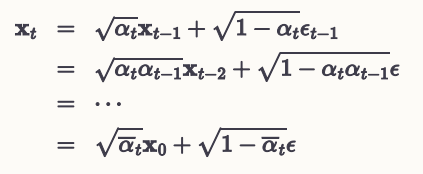   式1

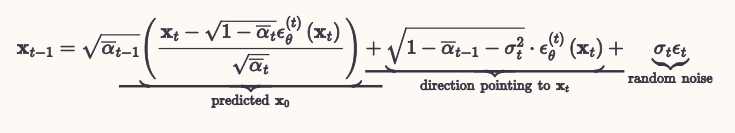

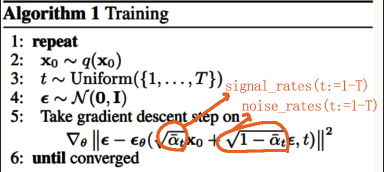
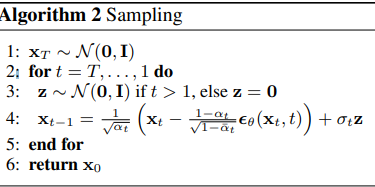

In [46]:
ddm=DiffusionModel()
ddm.normalizer.adapt(train)   #将训练数据的均值\方差作为层的权重

In [47]:
if LOAD_MODEL:
    ddm.built = True
    ddm.load_weights("./checkpoint/checkpoint.ckpt")

# Train Model

In [48]:
import platform
if platform.system() == "Darwin" and platform.processor() == "arm":
    opt = tf.keras.optimizers.legacy.Adam(learning_rate=LEARNING_RATE)
else:
    opt = tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE,weight_decay=WEIGHT_DECAY)



ddm.compile(
    #optimizer=optimizers.experimental.AdamW(
    #optimizer=optimizers.legacy.AdamW(
    #optimizer=optimizers.legacy.Adam(
    optimizer=opt,#(
        #learning_rate=LEARNING_RATE, weight_decay=WEIGHT_DECAY
    #),
    loss=losses.mean_absolute_error,
)

In [49]:
# run training and plot generated images periodically
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        generated_images = self.model.generate(
            num_images=self.num_img,
            diffusion_steps=PLOT_DIFFUSION_STEPS,
        ).numpy()
        display(
            generated_images,
            save_to="./output/generated_img_%03d.png" % (epoch),
        )


image_generator_callback = ImageGenerator(num_img=10)

Epoch 1/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1962
Saved to ./output/generated_img_000.png


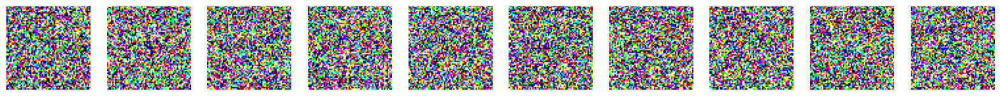

639/639 [==============================] - 1390s 2s/step - n_loss: 0.1962
Epoch 2/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1886
Saved to ./output/generated_img_001.png


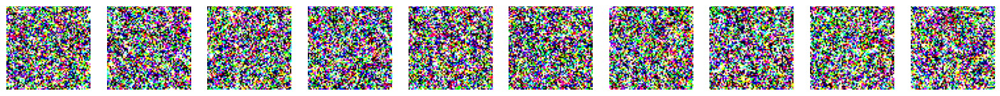

639/639 [==============================] - 1485s 2s/step - n_loss: 0.1886
Epoch 3/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1848
Saved to ./output/generated_img_002.png


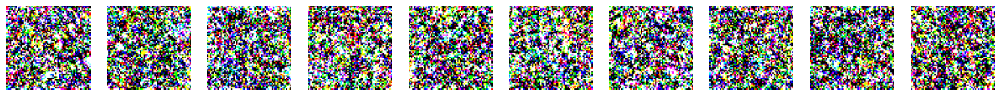

639/639 [==============================] - 1416s 2s/step - n_loss: 0.1848
Epoch 4/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1836
Saved to ./output/generated_img_003.png


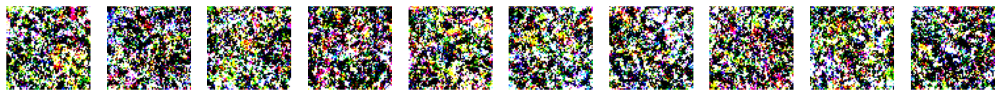

639/639 [==============================] - 1360s 2s/step - n_loss: 0.1836
Epoch 5/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1813
Saved to ./output/generated_img_004.png


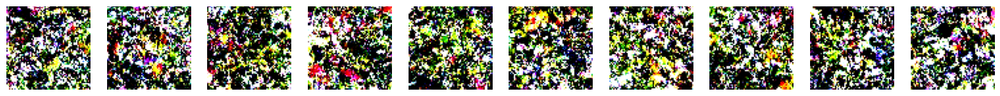

639/639 [==============================] - 1349s 2s/step - n_loss: 0.1813
Epoch 6/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1792
Saved to ./output/generated_img_005.png


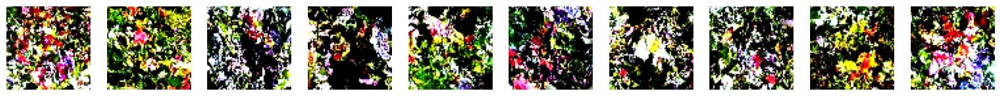

639/639 [==============================] - 1326s 2s/step - n_loss: 0.1792
Epoch 7/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1796
Saved to ./output/generated_img_006.png


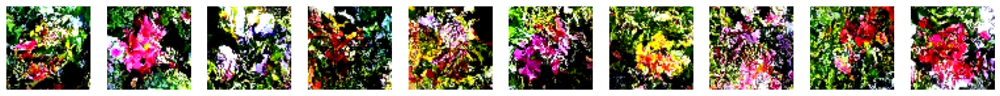

639/639 [==============================] - 1310s 2s/step - n_loss: 0.1796
Epoch 8/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1782
Saved to ./output/generated_img_007.png


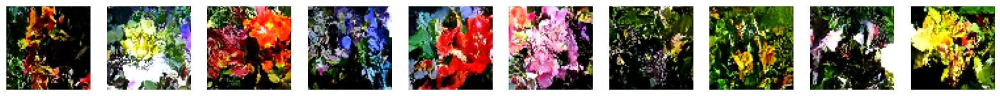

639/639 [==============================] - 1310s 2s/step - n_loss: 0.1782
Epoch 9/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1775 
Saved to ./output/generated_img_008.png


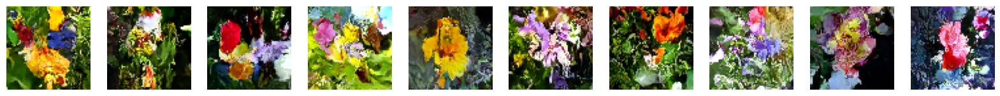

639/639 [==============================] - 7733s 12s/step - n_loss: 0.1775
Epoch 10/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1775 
Saved to ./output/generated_img_009.png


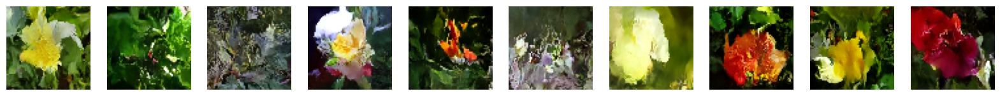

639/639 [==============================] - 9414s 15s/step - n_loss: 0.1775
Epoch 11/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1773 
Saved to ./output/generated_img_010.png


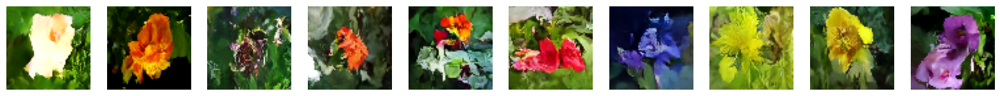

639/639 [==============================] - 8902s 14s/step - n_loss: 0.1773
Epoch 12/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1763 
Saved to ./output/generated_img_011.png


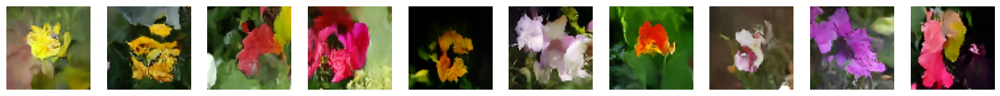

639/639 [==============================] - 9487s 15s/step - n_loss: 0.1763
Epoch 13/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1761 
Saved to ./output/generated_img_012.png


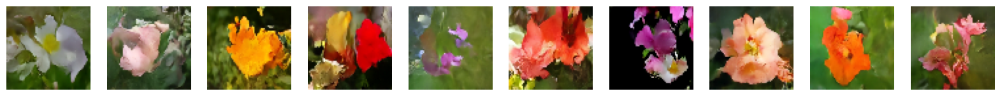

639/639 [==============================] - 9847s 15s/step - n_loss: 0.1761
Epoch 14/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1758 
Saved to ./output/generated_img_013.png


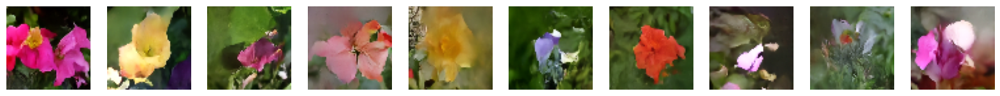

639/639 [==============================] - 9599s 15s/step - n_loss: 0.1758
Epoch 15/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1754 
Saved to ./output/generated_img_014.png


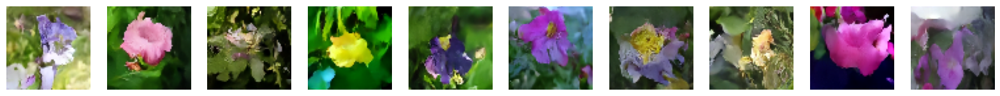

639/639 [==============================] - 9881s 15s/step - n_loss: 0.1754
Epoch 16/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1749 
Saved to ./output/generated_img_015.png


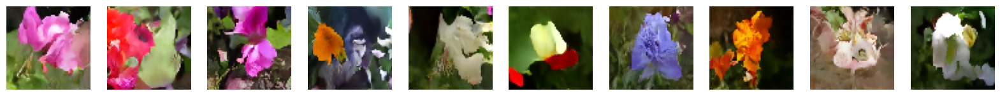

639/639 [==============================] - 8721s 14s/step - n_loss: 0.1749
Epoch 17/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1748 
Saved to ./output/generated_img_016.png


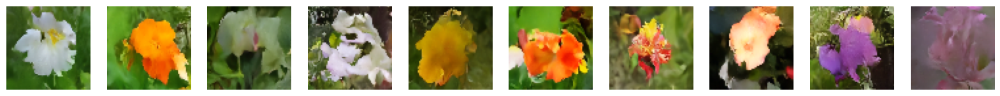

639/639 [==============================] - 10614s 17s/step - n_loss: 0.1748
Epoch 18/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1757 
Saved to ./output/generated_img_017.png


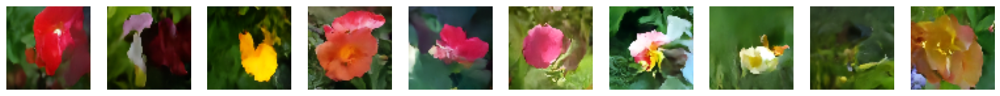

639/639 [==============================] - 8752s 14s/step - n_loss: 0.1757
Epoch 19/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1755 
Saved to ./output/generated_img_018.png


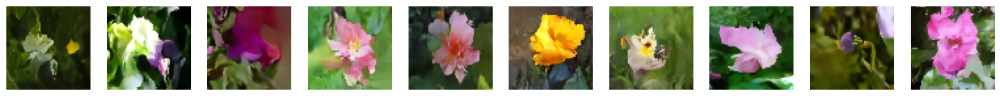

639/639 [==============================] - 8448s 13s/step - n_loss: 0.1755
Epoch 20/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1742 
Saved to ./output/generated_img_019.png


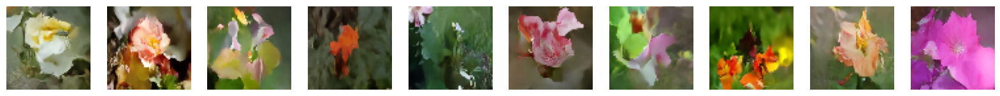

639/639 [==============================] - 9909s 16s/step - n_loss: 0.1742
Epoch 21/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1739 
Saved to ./output/generated_img_020.png


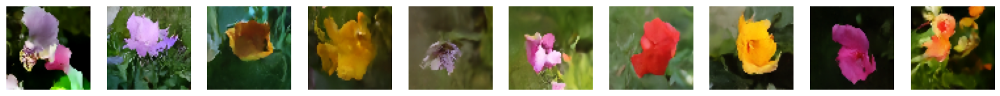

639/639 [==============================] - 9419s 15s/step - n_loss: 0.1739
Epoch 22/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1746 
Saved to ./output/generated_img_021.png


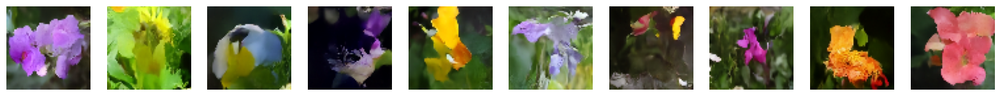

639/639 [==============================] - 8952s 14s/step - n_loss: 0.1746
Epoch 23/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1743 
Saved to ./output/generated_img_022.png


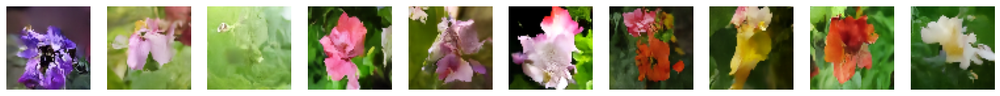

639/639 [==============================] - 9765s 15s/step - n_loss: 0.1743
Epoch 24/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1737 
Saved to ./output/generated_img_023.png


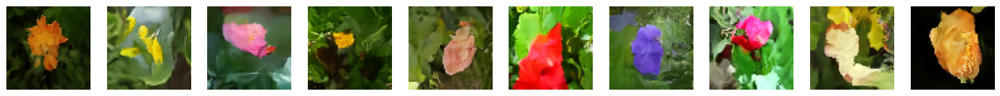

639/639 [==============================] - 9408s 15s/step - n_loss: 0.1737
Epoch 25/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1741 
Saved to ./output/generated_img_024.png


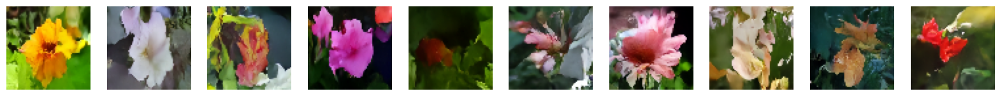

639/639 [==============================] - 8839s 14s/step - n_loss: 0.1741
Epoch 26/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1735 
Saved to ./output/generated_img_025.png


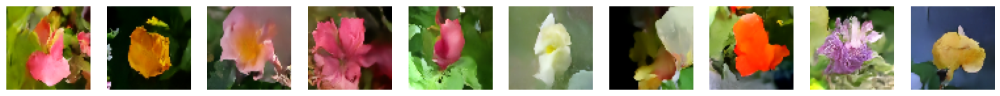

639/639 [==============================] - 9556s 15s/step - n_loss: 0.1735
Epoch 27/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1738 
Saved to ./output/generated_img_026.png


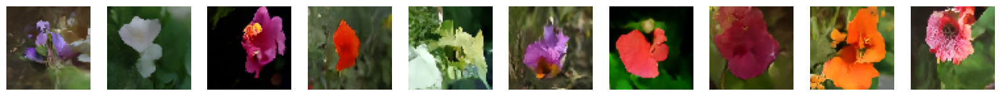

639/639 [==============================] - 8765s 14s/step - n_loss: 0.1738
Epoch 28/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1735 
Saved to ./output/generated_img_027.png


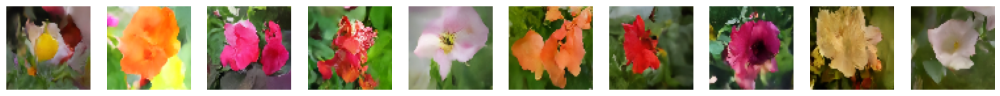

639/639 [==============================] - 9455s 15s/step - n_loss: 0.1735
Epoch 29/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1733 
Saved to ./output/generated_img_028.png


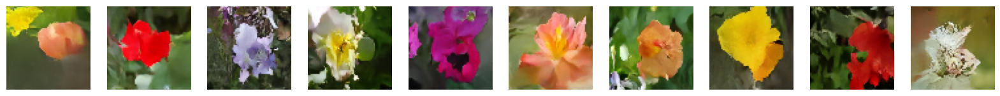

639/639 [==============================] - 8905s 14s/step - n_loss: 0.1733
Epoch 30/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1733
Saved to ./output/generated_img_029.png


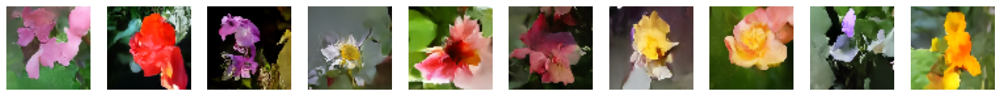

639/639 [==============================] - 5232s 8s/step - n_loss: 0.1733
Epoch 31/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1721
Saved to ./output/generated_img_030.png


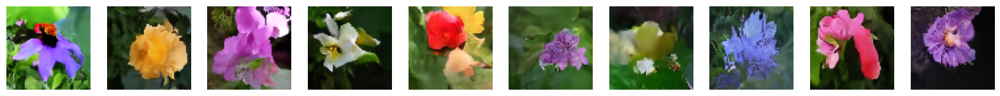

639/639 [==============================] - 1326s 2s/step - n_loss: 0.1721
Epoch 32/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1727
Saved to ./output/generated_img_031.png


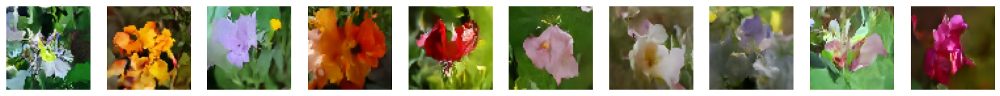

639/639 [==============================] - 1322s 2s/step - n_loss: 0.1727
Epoch 33/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1730
Saved to ./output/generated_img_032.png


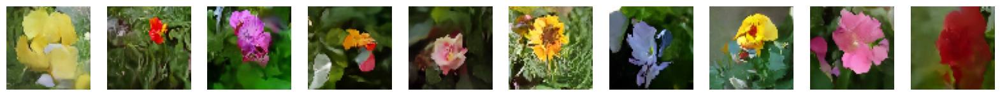

639/639 [==============================] - 1320s 2s/step - n_loss: 0.1730
Epoch 34/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1717
Saved to ./output/generated_img_033.png


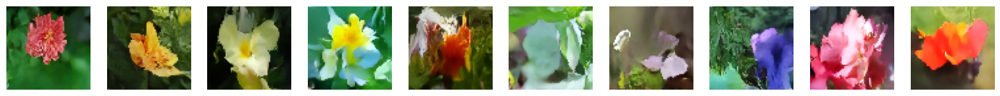

639/639 [==============================] - 1314s 2s/step - n_loss: 0.1717
Epoch 35/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1730
Saved to ./output/generated_img_034.png


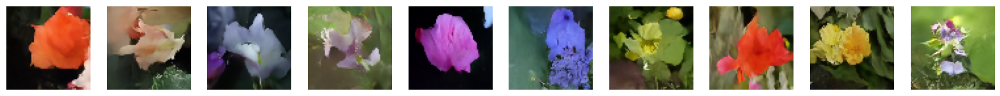

639/639 [==============================] - 1313s 2s/step - n_loss: 0.1730
Epoch 36/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1731
Saved to ./output/generated_img_035.png


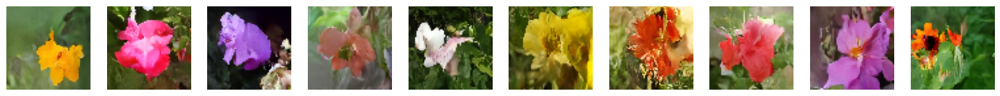

639/639 [==============================] - 2212s 3s/step - n_loss: 0.1731
Epoch 37/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1730 
Saved to ./output/generated_img_036.png


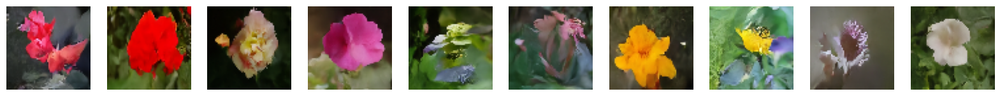

639/639 [==============================] - 9971s 16s/step - n_loss: 0.1730
Epoch 38/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1716 
Saved to ./output/generated_img_037.png


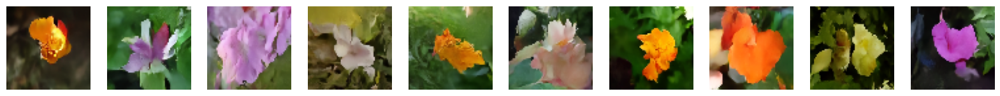

639/639 [==============================] - 9750s 15s/step - n_loss: 0.1716
Epoch 39/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1719 
Saved to ./output/generated_img_038.png


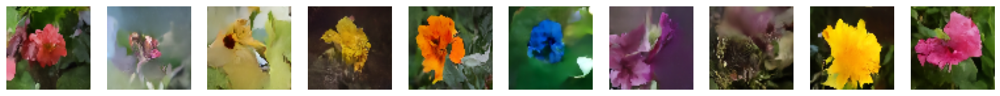

639/639 [==============================] - 8823s 14s/step - n_loss: 0.1719
Epoch 40/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1715 
Saved to ./output/generated_img_039.png


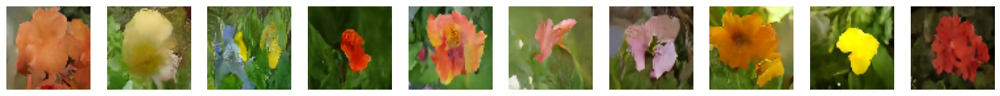

639/639 [==============================] - 9054s 14s/step - n_loss: 0.1715
Epoch 41/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1721
Saved to ./output/generated_img_040.png


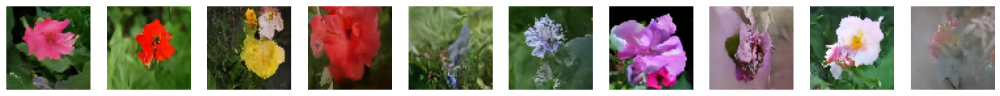

639/639 [==============================] - 1314s 2s/step - n_loss: 0.1721
Epoch 42/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1723
Saved to ./output/generated_img_041.png


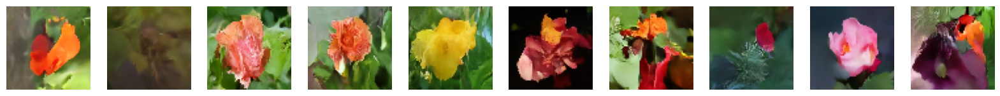

639/639 [==============================] - 1323s 2s/step - n_loss: 0.1723
Epoch 43/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1722
Saved to ./output/generated_img_042.png


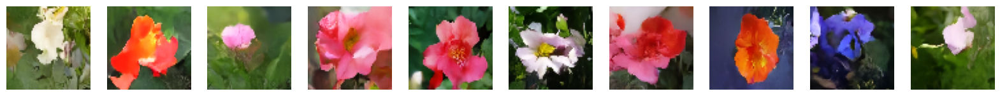

639/639 [==============================] - 1303s 2s/step - n_loss: 0.1722
Epoch 44/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1722
Saved to ./output/generated_img_043.png


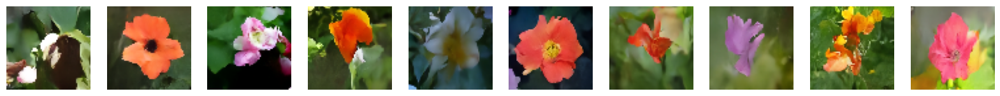

639/639 [==============================] - 1298s 2s/step - n_loss: 0.1722
Epoch 45/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1719
Saved to ./output/generated_img_044.png


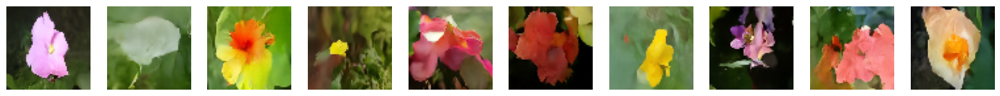

639/639 [==============================] - 1298s 2s/step - n_loss: 0.1719
Epoch 46/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1727
Saved to ./output/generated_img_045.png


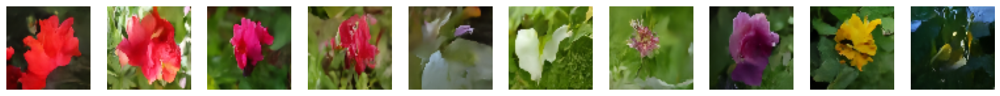

639/639 [==============================] - 1300s 2s/step - n_loss: 0.1727
Epoch 47/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1719
Saved to ./output/generated_img_046.png


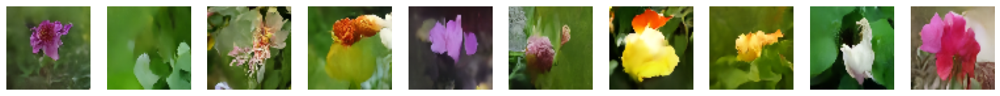

639/639 [==============================] - 1299s 2s/step - n_loss: 0.1719
Epoch 48/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1715
Saved to ./output/generated_img_047.png


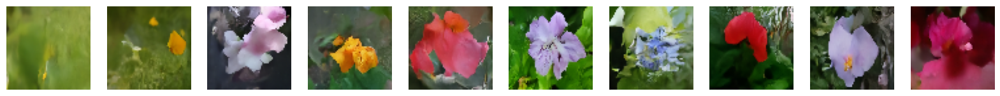

639/639 [==============================] - 1298s 2s/step - n_loss: 0.1715
Epoch 49/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1711
Saved to ./output/generated_img_048.png


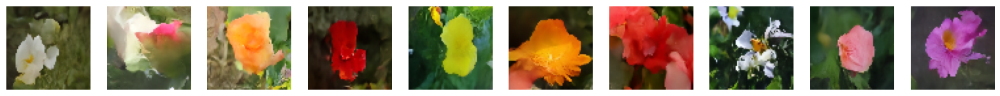

639/639 [==============================] - 4208s 7s/step - n_loss: 0.1711
Epoch 50/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1714 
Saved to ./output/generated_img_049.png


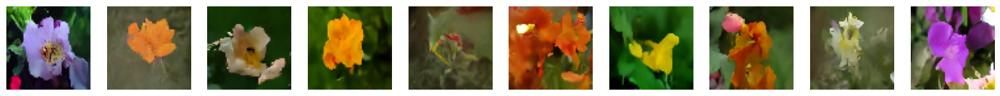

639/639 [==============================] - 9104s 14s/step - n_loss: 0.1714


In [50]:
ddm.fit(
    train,
    epochs=EPOCHS,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        image_generator_callback,
    ],
)